In [37]:
%matplotlib widget

import os
import numpy as np
import pandas as pd
import itertools as it
from glob import glob
import matplotlib.pyplot as plt
from sbpy.calib import Sun
from astropy import units as u
from astropy.io import fits
from astropy.visualization import simple_norm
from copy import deepcopy as copy

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from astropy.visualization import ImageNormalize, PercentileInterval, AsinhStretch

from lvmdrp import path as sdss_path
from lvmdrp import __version__ as drpver
from lvmdrp.core.constants import LVM_UNAM_URL
from lvmdrp.utils.examples import fetch_example_data, get_frames_metadata, fix_lamps_metadata, get_masters_metadata

from lvmdrp.core.plot import plot_image
from lvmdrp.core import rss, image, spectrum1d
from lvmdrp.functions import imageMethod, rssMethod, fluxCalMethod

plt.style.use("seaborn-v0_8-talk")

In [2]:
# define input data directory
data_path = os.path.abspath(os.path.join("..", "data"))

# let's create the output directory
output_path = "./data"
os.makedirs(output_path, exist_ok=True)

# create processed frames path template
out_main_path = os.path.join(output_path, "lvm-{kind}-{camera}-{expnum}.fits")
out_calib_path = os.path.join(output_path, "lvm-{mjd}-{kind}-{camera}-{exptime}.fits")

In [14]:
from lvmdrp.utils import metadata as md


raw_paths = md.locate_new_frames(hemi="s", mjd="*", camera="*", expnum="00000???")
frames_table = md.extract_metadata(raw_paths, kind="raw")

[INFO]: found 4137 potentially new raw frame paths in local SAS
[INFO]: locating all existing metadata stores
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and mjd = '*'
[INFO]: loading metadata store of kind = 'raw', tileid = '*' and 

In [103]:
frames_table = md.get_metadata(tileid="*", mjd="60???", kind="raw")
frames_table = frames_table.loc[~frames_table.mjd.isin([60008,60009,60037,60038])]
# fix arc lamps metadata
# fix_lamps_metadata(metadata=frames_table, lamp_names="argon neon ldls hgne xenon krypton".split())

[INFO]: loading metadata store at /home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60039/raw_metadata.hdf5
[INFO]: loading metadata store at /home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60010/raw_metadata.hdf5
[INFO]: loading metadata store at /home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60114/raw_metadata.hdf5
[INFO]: loading metadata store at /home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60041/raw_metadata.hdf5
[INFO]: loading metadata store at /home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60009/raw_metadata.hdf5
[INFO]: loading metadata store at /home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60037/raw_metada

[INFO]: starting preprocessing of raw image 'sdR-s-r2-00000680.fits.gz'
[INFO]: using header IMAGETYP = 'object'
[INFO]: exposure time 90.0 (s)
[WARNING]: assuming TRIMSEC = ['[1:2043, 2041:4080]', '[2078:4120, 2041:4080]', '[1:2043, 1:2040]', '[2078:4120, 1:2040]']
[WARNING]: assuming BIASSEC = ['[2044:2060, 2041:4080]', '[2061:2077, 2041:4080]', '[2044:2060, 1:2040]', '[2061:2077, 1:2040]']
[INFO]: using header GAIN = [2.63, 2.64, 2.65, 2.71] (e-/ADU)
[INFO]: median and standard deviation in OS quadrant 1: 1016.00 +/- 1.09 (ADU)
[INFO]: median and standard deviation in OS quadrant 2: 1003.00 +/- 1.08 (ADU)
[INFO]: median and standard deviation in OS quadrant 3: 994.00 +/- 1.20 (ADU)
[INFO]: median and standard deviation in OS quadrant 4: 995.00 +/- 1.16 (ADU)
[INFO]: using header RDNOISE = [3.2, 3.3, 3.0, 3.1] (ADU)
[INFO]: updating header with per quadrant stats
[INFO]: building pixel mask
[INFO]: replacing 0 masked pixels with NaNs
[INFO]: 0 (0 %) pixels masked
[INFO]: writing outp

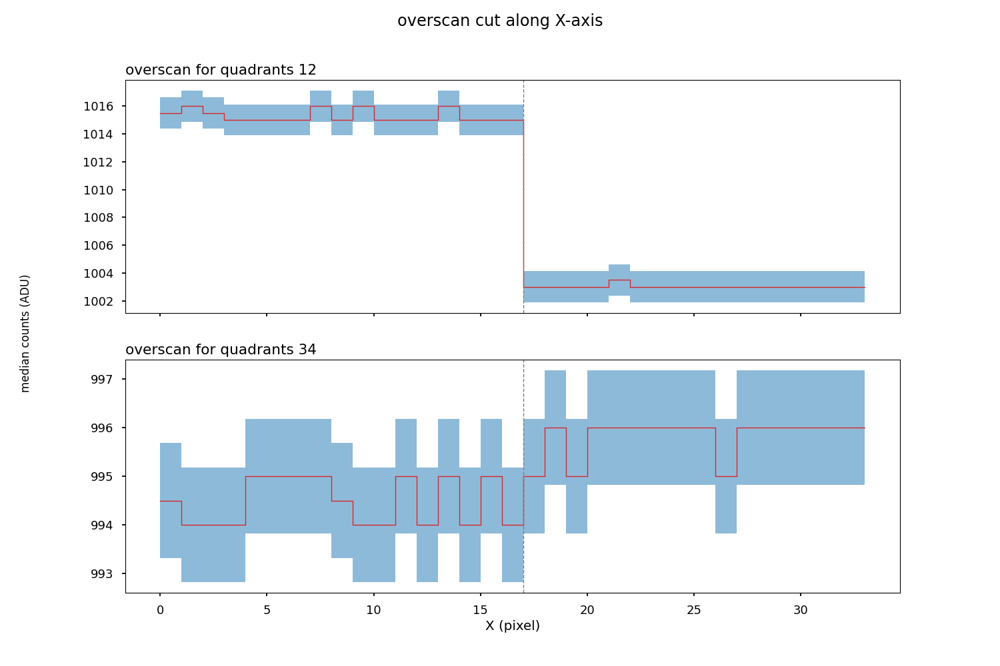

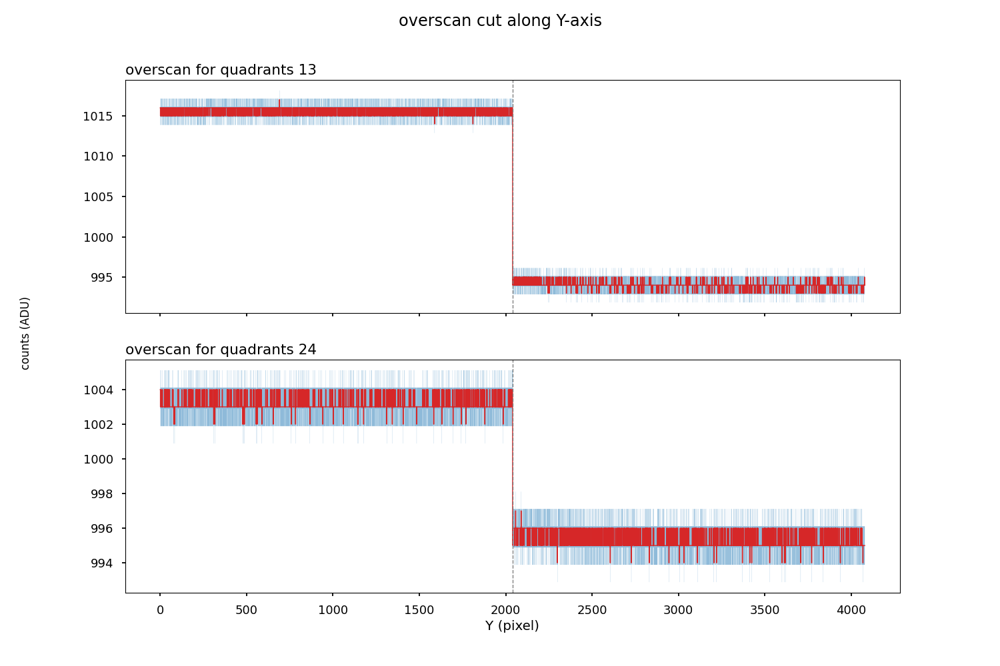

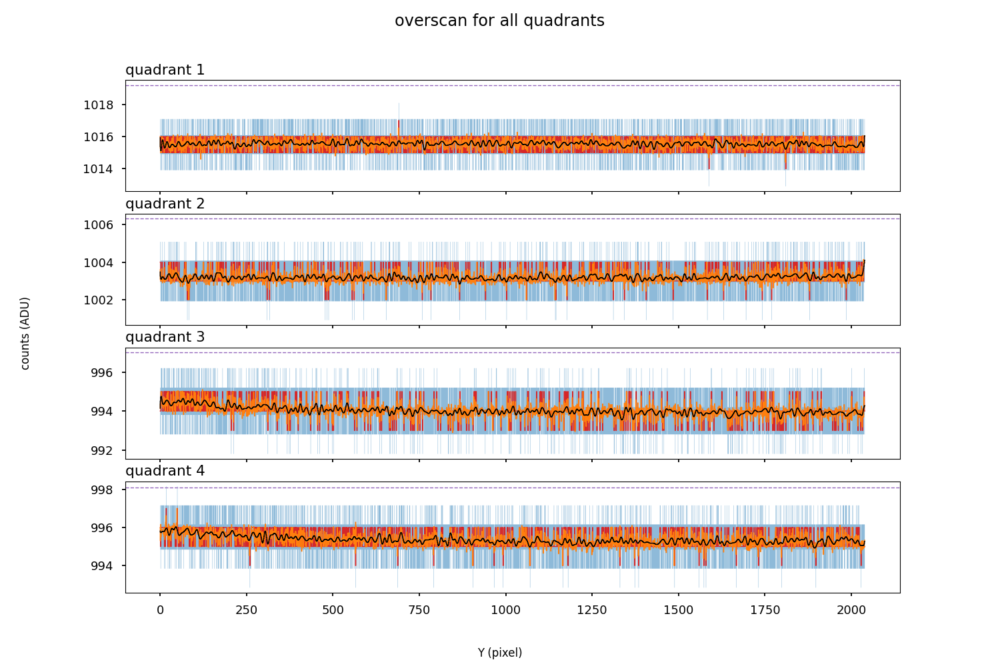

In [45]:
frame = frames_table.query("expnum==680 & camera=='r2'").iloc[0]
# frame = frames_table.query("expnum==562 & camera=='r3'").iloc[0]
# frame = frames_table.query("expnum==559 & camera=='z3'").iloc[0]
raw_path = sdss_path.full("lvm_raw", hemi=frame.hemi, mjd=frame.mjd, camspec=frame.camera, expnum=frame.expnum)
preproc_path = sdss_path.full("lvm_anc",
    drpver=drpver,
    tileid=frame.tileid,
    mjd=frame.mjd,
    kind="p",
    imagetype=frame.imagetyp,
    camera=frame.camera,
    expnum=frame.expnum
)
os.makedirs(os.path.dirname(preproc_path), exist_ok=True)
frame_camera, frame_expnum = frame.camera, frame.expnum

imageMethod.preproc_raw_frame(
    in_image=frame_path,
    out_image=preproc_path,
    subtract_overscan=True, overscan_stat="biweight",
    display_plots=True
)

In [91]:
calib_frames = md.match_master_metadata(target_imagetyp=frame.imagetyp, target_camera=frame.camera)

bias_frame = calib_frames["bias"]
dark_frame = calib_frames["dark"]


[INFO]: target frame of type 'object' needs calibration frames: bias, dark, pixelflat, flat, arc
[INFO]: loading metadata store at /home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/master_metadata.hdf5
[INFO]: found 18 master frames in store
[INFO]: final number of master frames after filtering 18
[INFO]: filtering by imagetyp = 'bias'
[INFO]: filtering by camera = 'r2'
[INFO]: found master bias
[INFO]: filtering by imagetyp = 'dark'
[INFO]: filtering by camera = 'r2'
[INFO]: found master dark
[INFO]: filtering by imagetyp = 'pixelflat'
[INFO]: filtering by camera = 'r2'
[WARNING]: no master pixelflat frame found
[INFO]: filtering by imagetyp = 'flat'
[INFO]: filtering by camera = 'r2'
[WARNING]: no master flat frame found
[INFO]: filtering by imagetyp = 'arc'
[INFO]: filtering by camera = 'r2'
[WARNING]: no master arc frame found


[INFO]: target frame parameters: MJD = 60041, exptime = 90.0, camera = r2
[INFO]: using bias calibration frame '/home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60115/calib/lvm-mbias-r2.fits'
[WARNING]: master dark '/home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60115/calib/lvm-mdark-r2-900.0.fits' not found. Using dummy dark
[INFO]: subtracting master bias
[INFO]: calculating Poisson errors per quadrant
[INFO]: median error in quadrant 1: 4.17 (e-/s)
[INFO]: median error in quadrant 2: 3.97 (e-/s)
[INFO]: median error in quadrant 3: 4.00 (e-/s)
[INFO]: median error in quadrant 4: 3.79 (e-/s)
[INFO]: subtracting master dark
[INFO]: propagating pixel mask
[INFO]: replacing 0 masked pixels with NaNs
[INFO]: rejecting cosmic rays


INFO: array provided for uncertainty; assuming it is a StdDevUncertainty. [astropy.nddata.ccddata]


[WARNING]: found cosmic ray 10337 pixels
[INFO]: saving detrended image at '/home/mejia/Research/UNAM/lvm-drp/lvmdrp/examples/data/lco_com/sas/sdsswork/lvm/spectro/redux/0.1.0.dev0/1111/60041/ancillary/lvm-cobject-r2-00000680.fits'
[INFO]: plotting results
[WARNING]: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect. (UserWarning)


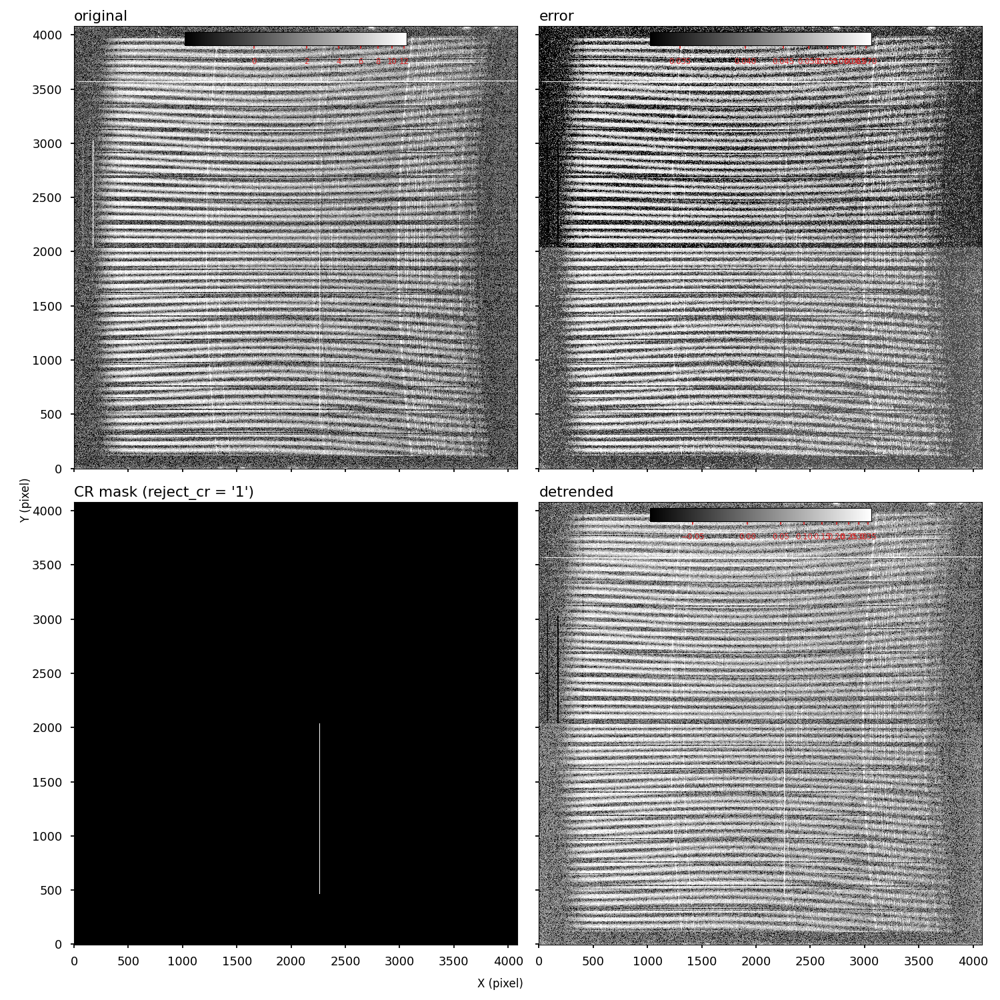

[WARNING]: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect. (UserWarning)


In [92]:
detrended_path = sdss_path.full("lvm_anc", drpver=drpver, hemi=frame.hemi, tileid=frame.tileid, mjd=frame.mjd, kind="c", imagetype=frame.imagetyp, camera=frame.camera, expnum=frame.expnum)

mbias_path = sdss_path.full("lvm_cal_mbias", tileid=bias_frame.tileid, camera=bias_frame.camera, drpver=drpver, mjd=bias_frame.mjd)
mdark_path = sdss_path.full("lvm_cal_time", drpver=drpver, tileid=dark_frame.tileid, mjd=dark_frame.mjd, kind="mdark", camera=dark_frame.camera, exptime=dark_frame.exptime)

imageMethod.detrend_frame(
    in_image=preproc_path,
    out_image=detrended_path,
    in_bias=mbias_path,
    in_dark=mdark_path,
    reject_cr=True, display_plots=True
)

16524


[WARNING]: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect. (UserWarning)


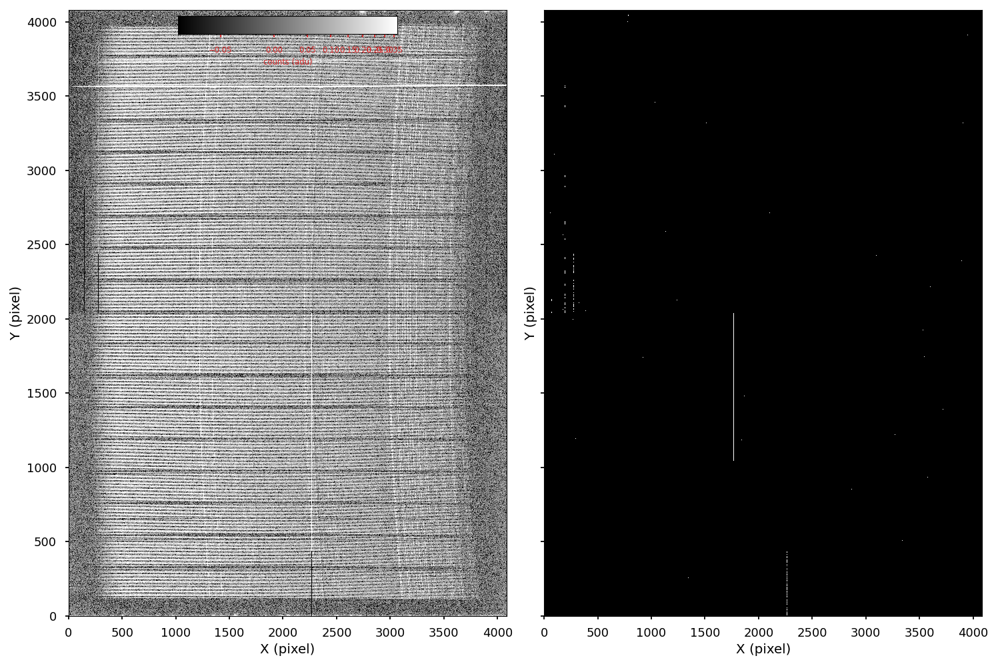

In [105]:
from astropy.nddata import CCDData, StdDevUncertainty
from ccdproc import cosmicray_lacosmic

detrended_image = image.loadImage(detrended_path)


ccd = CCDData(
    detrended_image._data*detrended_image._header["EXPTIME"],
    uncertainty=StdDevUncertainty(detrended_image._error*detrended_image._header["EXPTIME"]),
    unit=u.electron,
    mask=detrended_image._mask,
)
clean_ccd = cosmicray_lacosmic(ccd, sigclip=30.0, objlim=np.percentile(detrended_image._data, q=99.9))
cr_mask = clean_ccd.mask
cr_mask[detrended_image._mask] = False
clean_image = image.Image(data=clean_ccd.data, mask=cr_mask)
# update image with cosmic ray mask
# detrended_image.setData(mask=(detrended_image._mask | clean_image._mask))

print(cr_mask.sum())

fig, axs = plt.subplots(1, 2, figsize=(15,10), sharex=True, sharey=True)
plot_image(detrended_image, ax=axs[0])
plot_image(clean_image, ax=axs[1], extension="mask")
fig.tight_layout()

In [7]:
# cr_mask = detrended_image.createCosmicMask()
# clean_image = image.Image(data=detrended_image._data, mask=cr_mask)

# print(cr_mask.sum())

# fig, axs = plt.subplots(1, 2, figsize=(15,10), sharex=True, sharey=True)
# plot_image(detrended_image, ax=axs[0])
# plot_image(clean_image, ax=axs[1], extension="mask")
# fig.tight_layout()

[WARNING]: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect. (UserWarning)


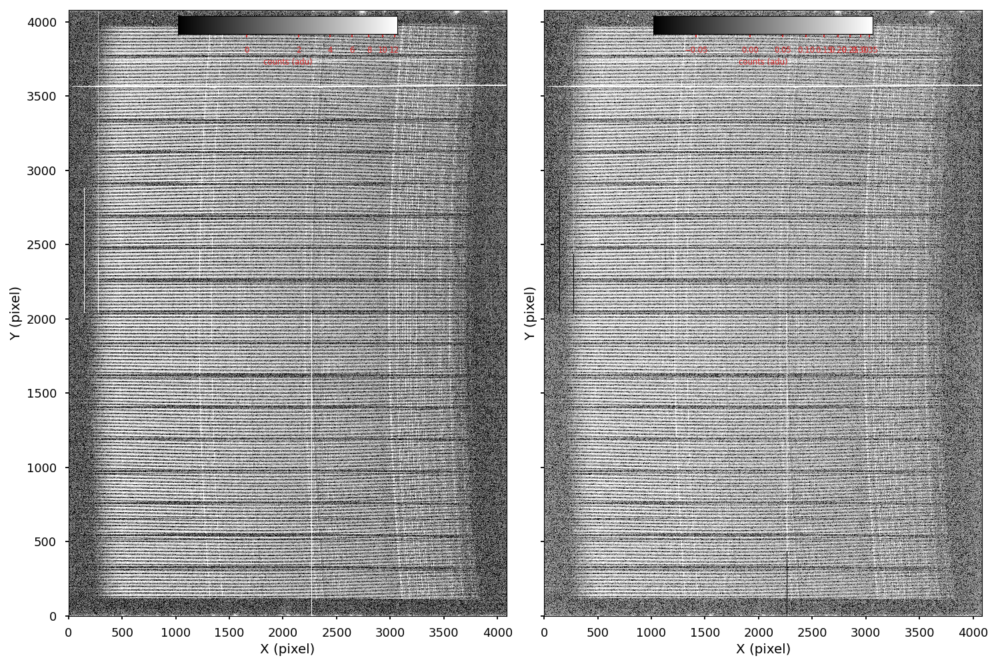

In [94]:
pre = image.loadImage(preproc_path)
img = image.loadImage(detrended_path)

fig, axs = plt.subplots(1, 2, figsize=(15,10), sharex=True, sharey=True)
plot_image(pre, ax=axs[0])
plot_image(img, ax=axs[1])
fig.tight_layout()

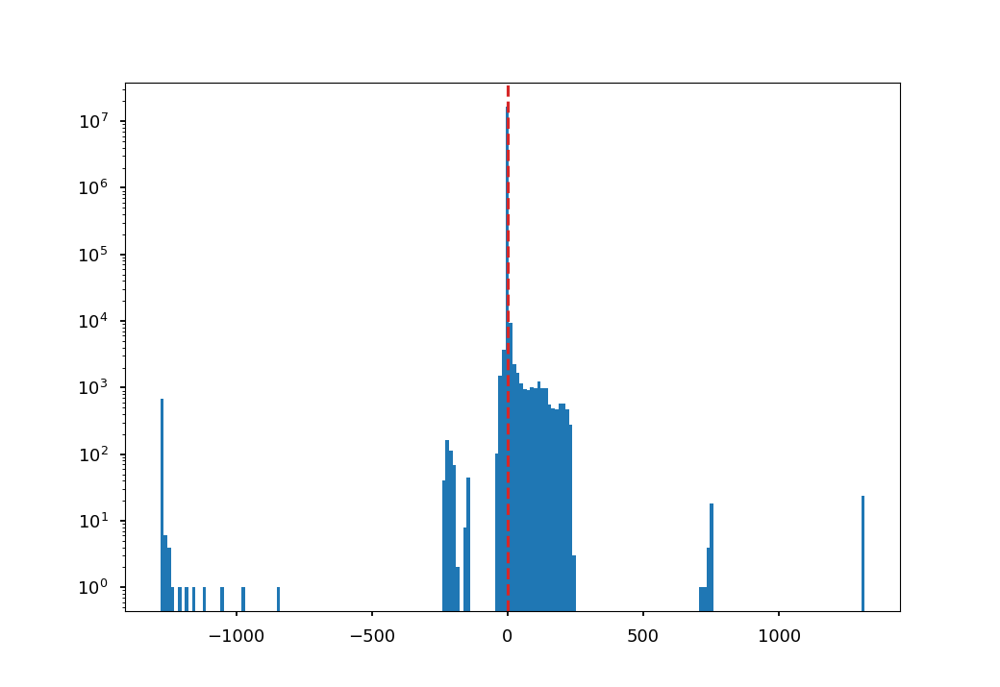

In [95]:
from scipy.ndimage import median_filter
from scipy.signal import medfilt2d
from scipy.stats import sigmaclip

img_array = np.ma.masked_array(img._data, mask=img._mask, fill_value=np.nan)

plt.figure()
plt.hist(img_array.filled().flatten(), bins=200)
plt.axvline(np.nanpercentile(img_array.filled(np.nan), 99.5), ls="--", color="tab:red")
# plt.xscale("log")
plt.yscale("log")

[WARNING]: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect. (UserWarning)


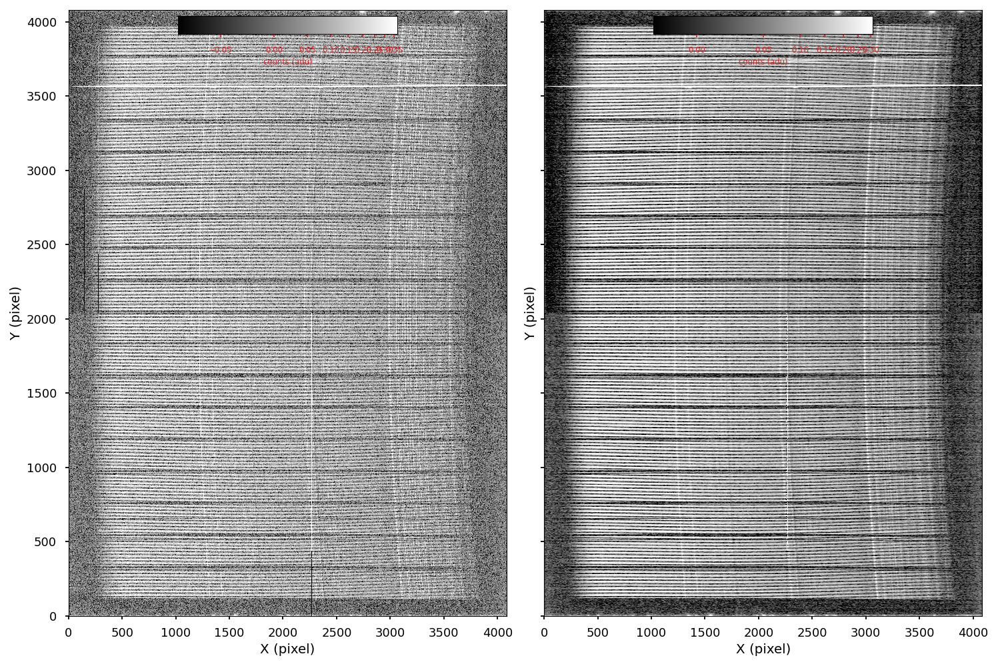

In [96]:
fig, axs = plt.subplots(1, 2, figsize=(15,10), sharex=True, sharey=True)

plot_image(img, ax=axs[0], colorbar=True, use_mask=True)

median_img = img.medianImg(size=(1,15), use_mask=True)
plot_image(median_img, ax=axs[1], colorbar=True, use_mask=True)
fig.tight_layout()

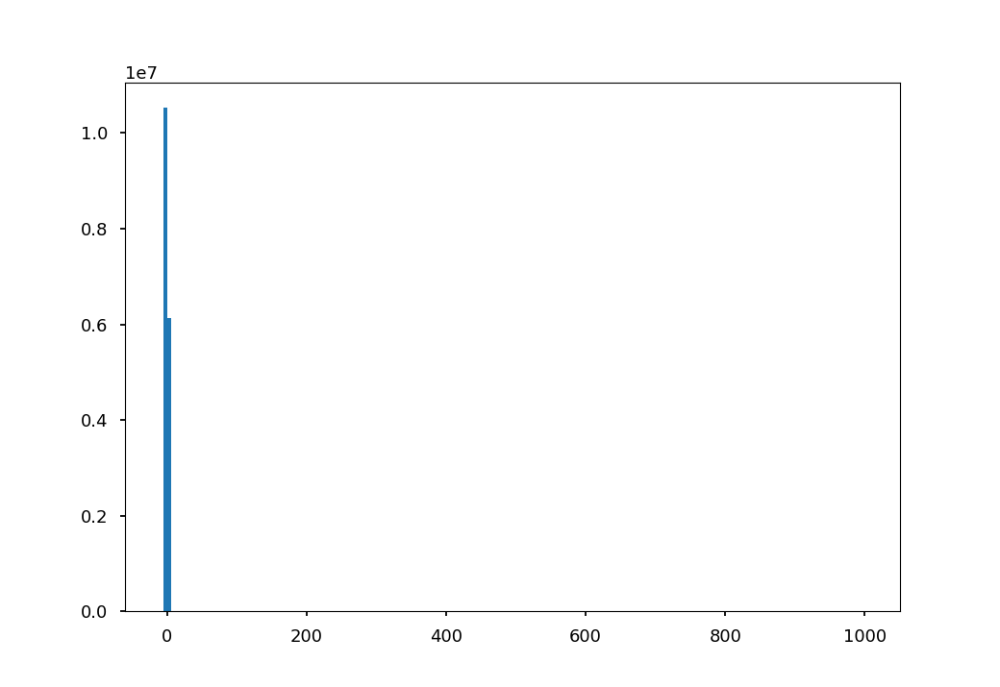

In [97]:
plt.figure()
plt.hist(median_img._data.flatten(), bins=200, range=(-10, 1000));

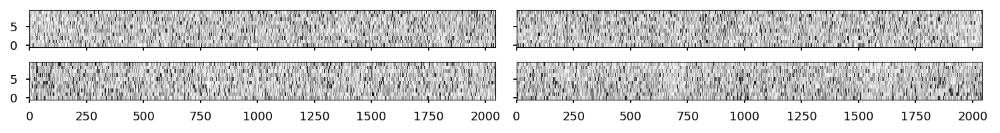

In [98]:
fig, axs = plt.subplots(2, 2, figsize=(15,2), sharex=True, sharey=True)
axs = axs.flatten()
plot_image(img.getSection(img._header["AMP1 TRIMSEC"]).getSection("[1:2043, 61:70]"), ax=axs[0], labels=False, colorbar=False)
plot_image(img.getSection(img._header["AMP2 TRIMSEC"]).getSection("[1:2043, 61:70]"), ax=axs[1], labels=False, colorbar=False)
plot_image(img.getSection(img._header["AMP3 TRIMSEC"]).getSection("[1:2043, 1991:2000]"), ax=axs[2], labels=False, colorbar=False)
plot_image(img.getSection(img._header["AMP4 TRIMSEC"]).getSection("[1:2043, 1991:2000]"), ax=axs[3], labels=False, colorbar=False)

fig.tight_layout()

[WARNING]: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect. (UserWarning)


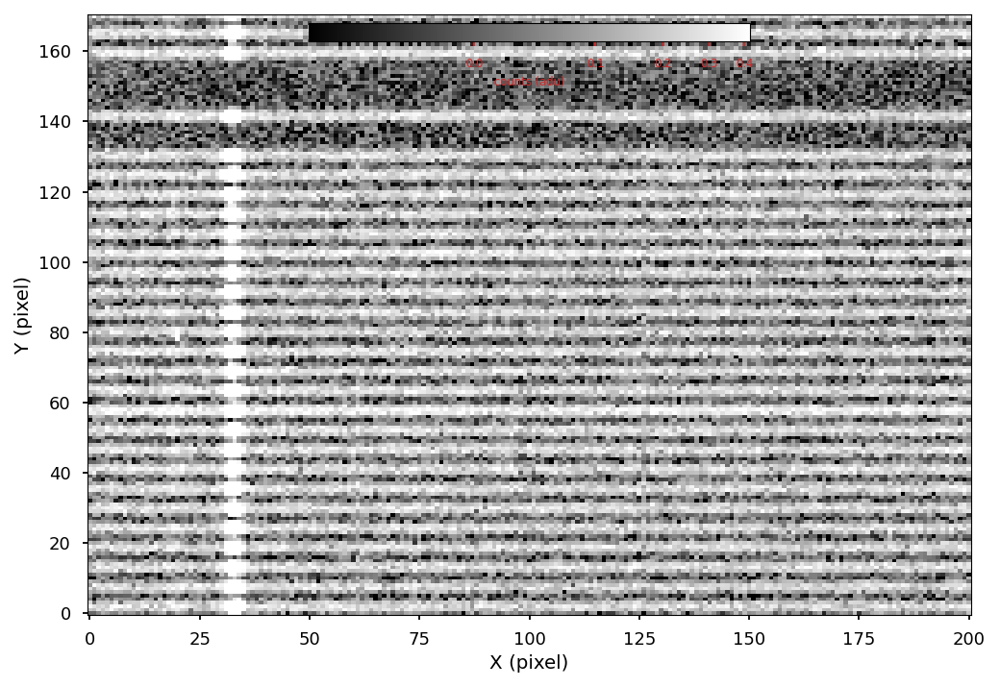

In [99]:
# sub_img = img.getSection("[1300:1400, 1040:1100]")
sub_img = img.getSection("[1300:1500, 1900:2070]")

plt.figure()
# norm = simple_norm(sub_img._data, stretch="log", clip=True)
# plt.imshow(sub_img._data, origin="lower", norm=norm)
plot_image(sub_img, ax=plt.gca())
plt.tight_layout()

In [14]:
# sub_img_copy = copy(sub_img)
# cr_mask = sub_img_copy.createCosmicMask(iter=1, sigma_det=2, flim=1.1, parallel=1)

# plt.figure(figsize=(10,10))
# plt.imshow(cr_mask, origin="lower")
# plt.tight_layout()

In [15]:
# norm = simple_norm(img._data, stretch="log", clip=True)
# fig, axs = plt.subplots(1, 2, figsize=(15,10), sharex=True, sharey=True)
# axs[0].imshow(sub_img._data, origin="lower", norm=norm)
# axs[1].imshow(sub_img_copy._data, origin="lower", norm=norm)
# fig.tight_layout()